# I used this notebook to analyze dataset, see sign types and select reduntant labels

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from utils.dataset import *

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np
import random
import json
import os
from collections import Counter
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

In [2]:
train = read_list_from_file('/mnt/CommonData/dataset/mtsd_fully_annotated/splits/train.txt')
val = read_list_from_file('/mnt/CommonData/dataset/mtsd_fully_annotated/splits/val.txt')
test = read_list_from_file('/mnt/CommonData/dataset/mtsd_fully_annotated/splits/test.txt')

In [3]:
train_annotations = get_annotations(train, '/home/pkos/Desktop/mtsd_fully_annotated/annotations')
val_annotations = get_annotations(val, '/home/pkos/Desktop/mtsd_fully_annotated/annotations')
#test_annotations = get_annotations(test)


In [4]:
train_annotations['aVuSPwmImhhe01o_hJm7IA']['objects'][0]

with open('./lbl_id_map.pkl', 'rb') as f:
        lbl_id_map = pickle.load(f)
        

In [8]:
#sign types: warning, regulatory, complementary, information
def get_labels(annots):
    labels = []
    for img in annots:
        for obj in annots[img]['objects']:
            labels.append(obj['label'])
    labels_with_counts = Counter(labels)
    return labels_with_counts


train_labels = get_labels(train_annotations)
label_names = list(train_labels.keys())
val_labels = get_labels(val_annotations)

warning_signs = list(filter(lambda l: l.startswith('warning'), label_names))
regulatory_signs = list(filter(lambda l: l.startswith('regulatory'), label_names))
information_signs = list(filter(lambda l: l.startswith('information'), label_names))
complementary_signs = list(filter(lambda l: l.startswith('complementary'), label_names))

#test_labels = get_labels(test_annotations)

In [9]:
labels = get_labels(train_annotations)

In [ ]:
labels.most_common()

In [8]:
excluded_labels=complementary_signs
excluded_labels.append('regulatory--no-parking--g6')
excluded_labels.append('information--highway-interstate-route--g2')
excluded_labels.append('information--interstate-route--g1')
excluded_labels.append('information--parking--g3')#?
excluded_labels.append('information--pedestrians-crossing--g2')#?
excluded_labels.append('regulatory--left-turn-yield-on-green--g1')#?
excluded_labels.append('regulatory--passing-lane-ahead--g1')
excluded_labels.append('warning--kangaloo-crossing--g1')
excluded_labels.append('other-sign')
#excluded_labels.append('regulatory--bicycles-only--g2'/g3 tez)#?
#excluded_labels.append('regulatory--do-not-block-intersection--g1')#?
#excluded_labels.append('regulatory--go-straight-or-turn-left--g3'/left--g3)#?



filtered_labels = [l for l in label_names if l not in excluded_labels]


In [10]:
%matplotlib qt
def get_x_imgs(label,x):
    imgs = []
    annots = list(train_annotations.keys())
    random.shuffle(annots)
    for annot in annots:
        for obj in train_annotations[annot]['objects']:
            if obj['label'].find(label)!=-1:
                img= mpimg.imread('/mnt/CommonData/dataset/mtsd_fully_annotated/images/' + annot + '.jpg')
                bbox = obj['bbox']
                img = img[int(bbox['ymin']):int(bbox['ymax']), int(bbox['xmin']): int(bbox['xmax']),:]
                imgs.append(img)
                if(len(imgs) >= x):
                    return imgs
    return imgs

def disp_imgs(imgs):
    fig=plt.figure(figsize=(10, 3))
    columns = 8
    rows = 1
    for i in range(1, columns*rows +1):
        fig.add_subplot(rows, columns, i)
        plt.imshow(imgs[min(i-1,len(imgs)-1)])
    plt.show()

complementary--both-directions--g1
107


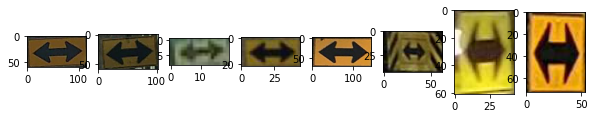

complementary--both-directions--g2
132


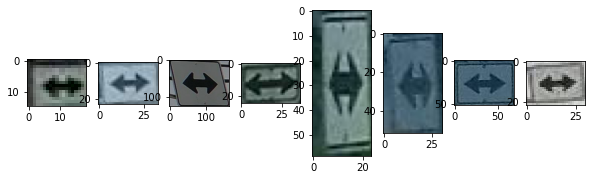

complementary--buses--g1
43


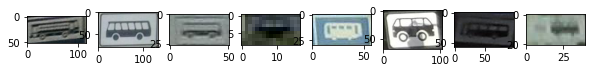

complementary--chevron-left--g1
1570


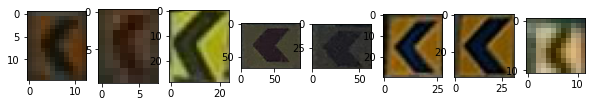

complementary--chevron-left--g2
79


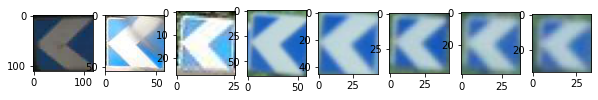

complementary--chevron-left--g3
222


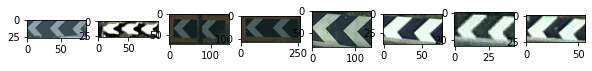

complementary--chevron-left--g4
74


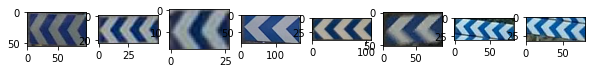

complementary--chevron-left--g5
263


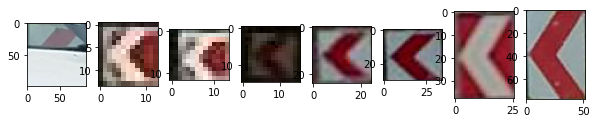

complementary--chevron-right--g1
1340


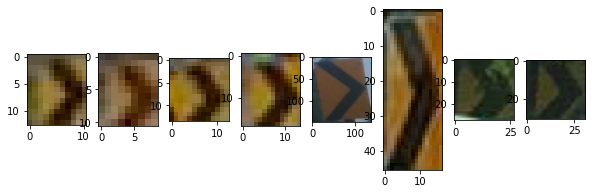

complementary--chevron-right--g2
111


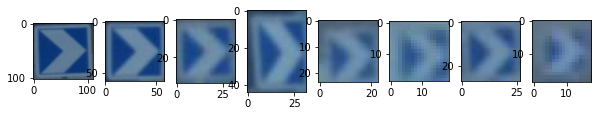

complementary--chevron-right--g3
237


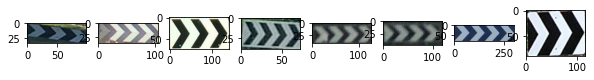

complementary--chevron-right--g4
68


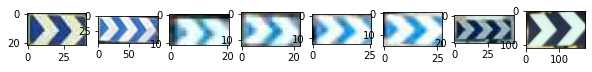

complementary--chevron-right--g5
277


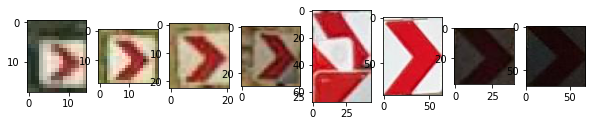

complementary--distance--g1
160


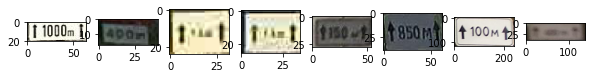

complementary--distance--g2
227


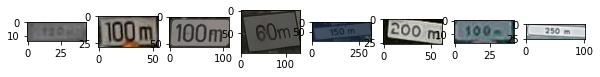

complementary--distance--g3
277


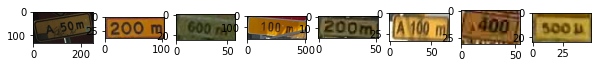

complementary--except-bicycles--g1
60


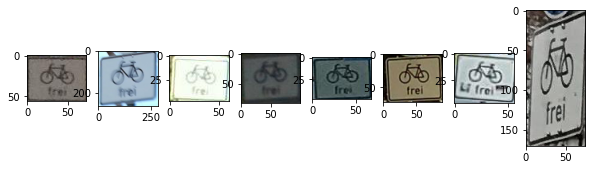

complementary--go-left--g1
312


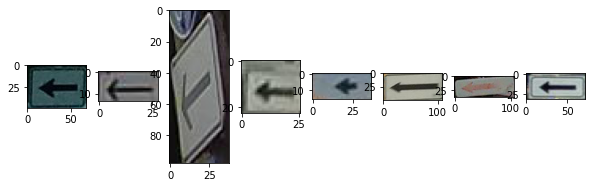

complementary--go-right--g1
331


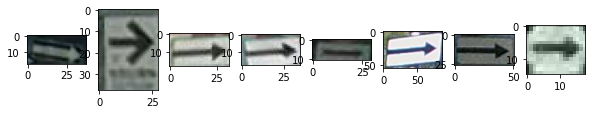

complementary--go-right--g2
63


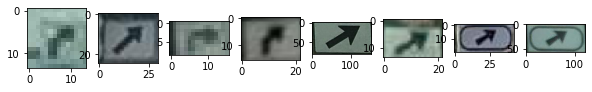

complementary--keep-left--g1
328


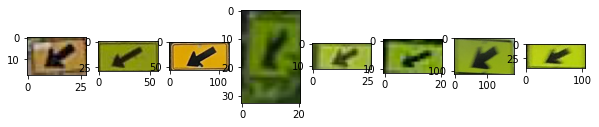

complementary--keep-right--g1
74


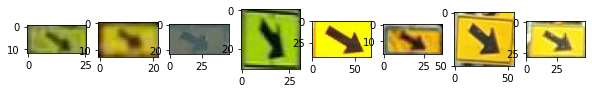

complementary--maximum-speed-limit-15--g1
88


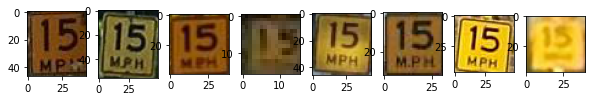

complementary--maximum-speed-limit-20--g1
106


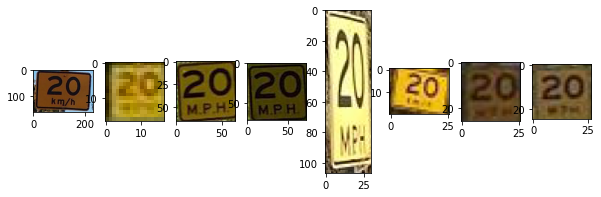

complementary--maximum-speed-limit-25--g1
96


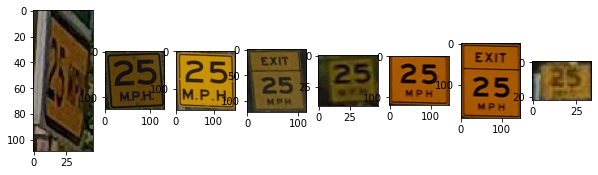

complementary--maximum-speed-limit-30--g1
77


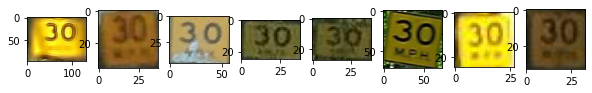

complementary--maximum-speed-limit-35--g1
111


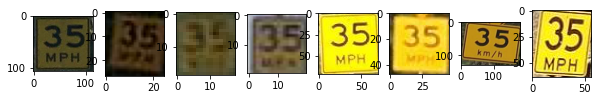

complementary--maximum-speed-limit-40--g1
59


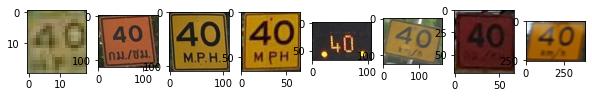

complementary--maximum-speed-limit-45--g1
144


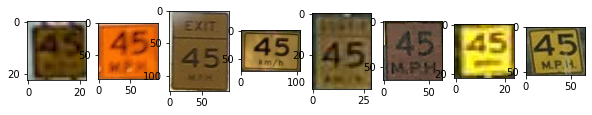

complementary--maximum-speed-limit-55--g1
78


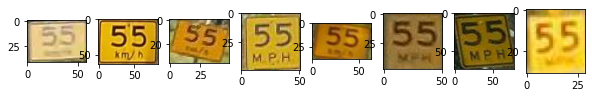

complementary--maximum-speed-limit-70--g1
46


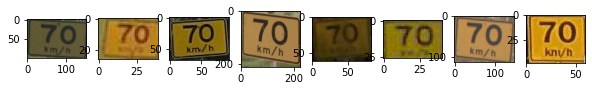

complementary--maximum-speed-limit-75--g1
46


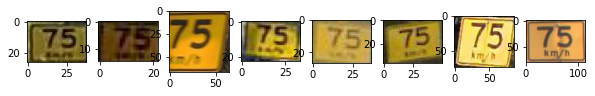

complementary--obstacle-delineator--g1
136


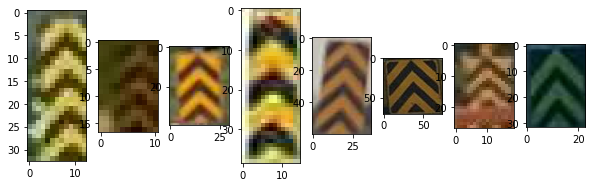

complementary--obstacle-delineator--g2
573


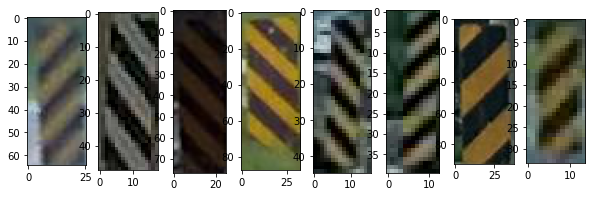

complementary--one-direction-left--g1
78


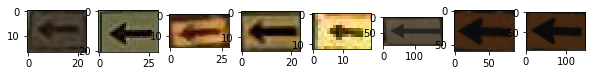

complementary--one-direction-right--g1
89


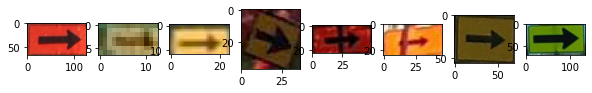

complementary--pass-right--g1
66


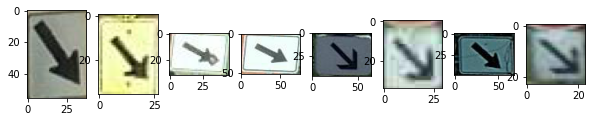

complementary--tow-away-zone--g1
73


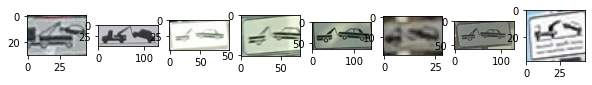

complementary--trucks--g1
99


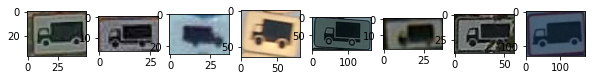

complementary--trucks-turn-right--g1
64


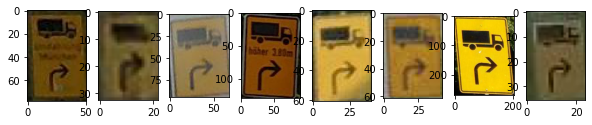

complementary--turn-left--g2
154


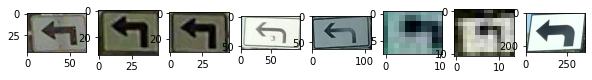

complementary--turn-right--g2
79


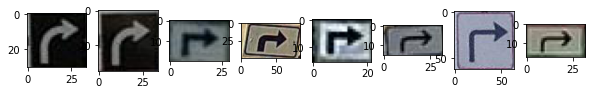

information--airport--g1
35


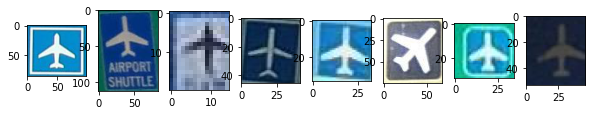

information--airport--g2
67


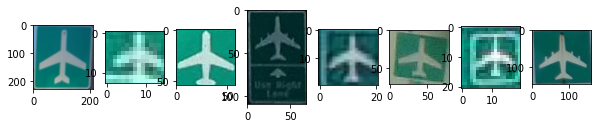

information--bike-route--g1
85


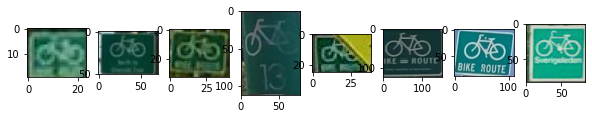

information--bus-stop--g1
88


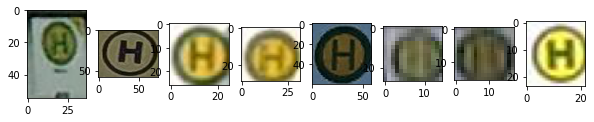

information--children--g1
74


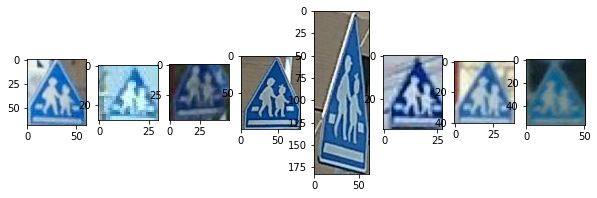

information--dead-end--g1
126


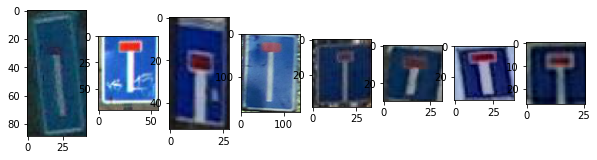

information--disabled-persons--g1
214


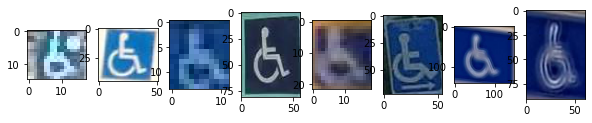

information--emergency-facility--g2
61


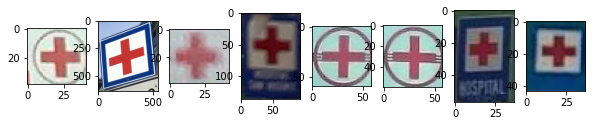

information--end-of-built-up-area--g1
54


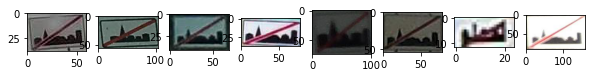

information--end-of-motorway--g1
130


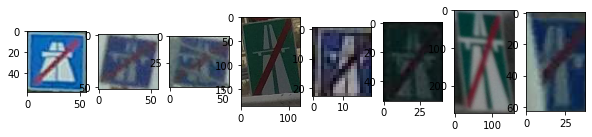

information--food--g2
66


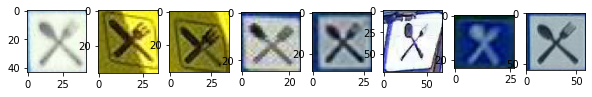

information--gas-station--g1
50


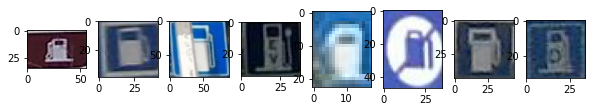

information--gas-station--g3
45


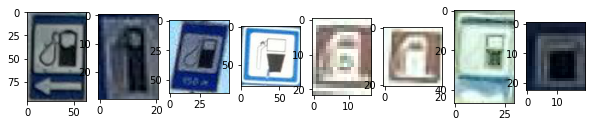

information--highway-exit--g1
85


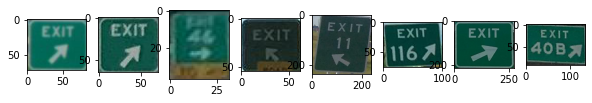

information--highway-interstate-route--g2
6


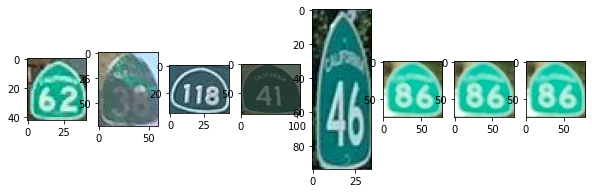

information--hospital--g1
144


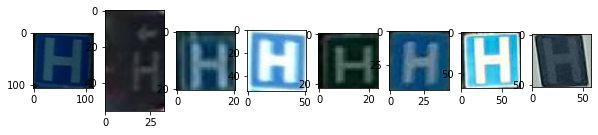

information--interstate-route--g1
37


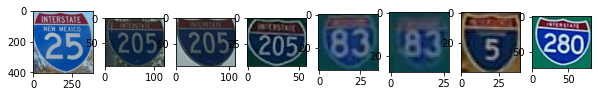

information--limited-access-road--g1
92


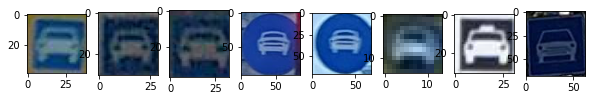

information--living-street--g1
58


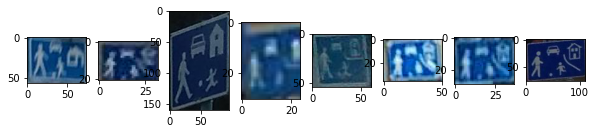

information--motorway--g1
192


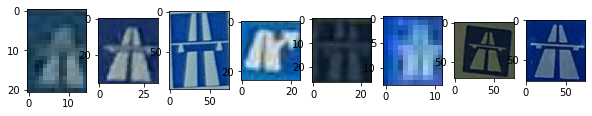

information--parking--g1
1414


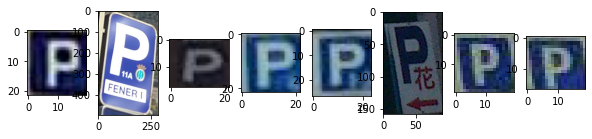

information--parking--g2
79


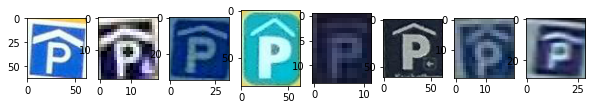

information--parking--g3
217


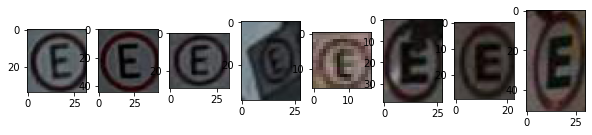

information--parking--g5
131


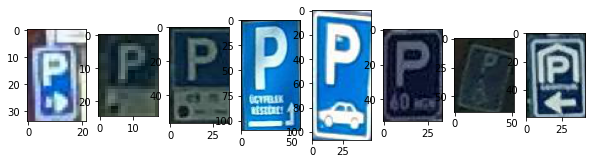

information--parking--g6
68


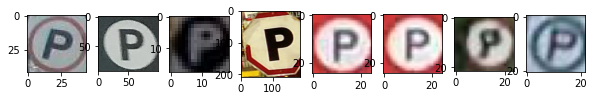

information--pedestrians-crossing--g1
1914


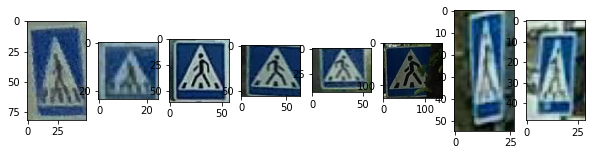

information--pedestrians-crossing--g2
74


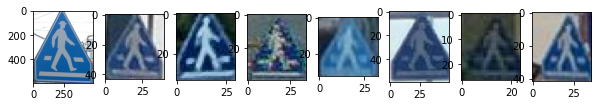

information--road-bump--g1
94


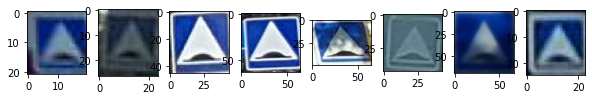

information--safety-area--g2
83


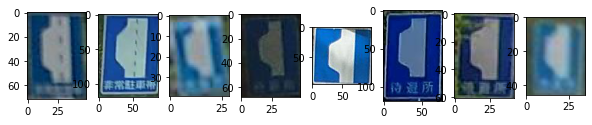

information--telephone--g1
43


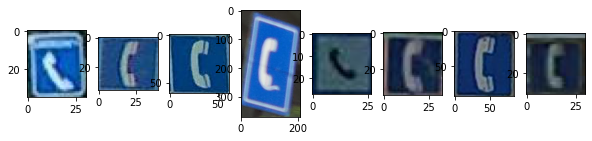

information--telephone--g2
40


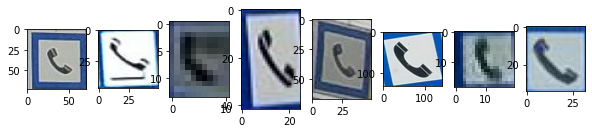

information--trailer-camping--g1
53


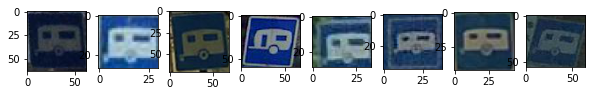

information--tram-bus-stop--g2
125


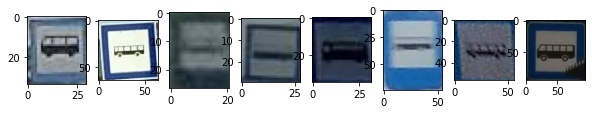

other-sign
122501


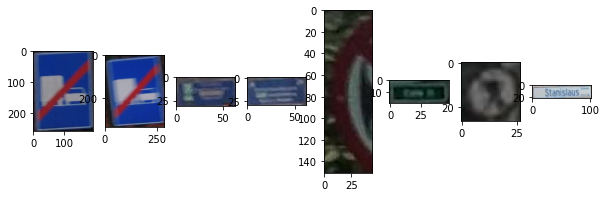

regulatory--bicycles-only--g1
248


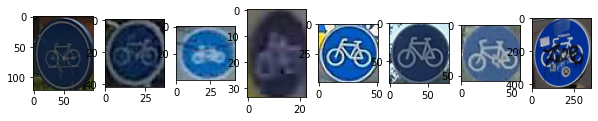

regulatory--bicycles-only--g2
22


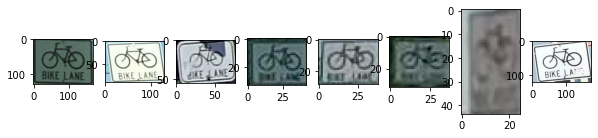

regulatory--bicycles-only--g3
33


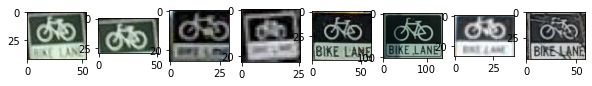

regulatory--buses-only--g1
65


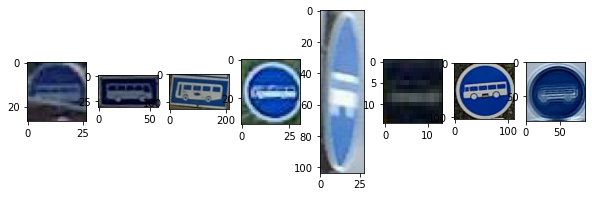

regulatory--do-not-block-intersection--g1
50


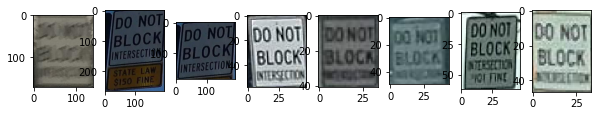

regulatory--dual-lanes-go-straight-on-left--g1
56


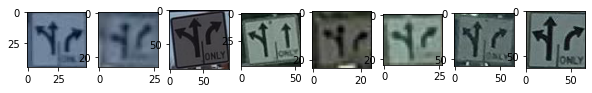

regulatory--dual-lanes-go-straight-on-right--g1
44


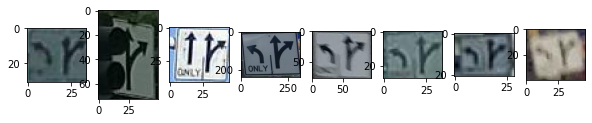

regulatory--dual-path-bicycles-and-pedestrians--g1
52


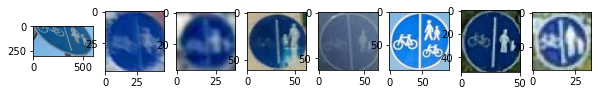

regulatory--end-of-bicycles-only--g1
50


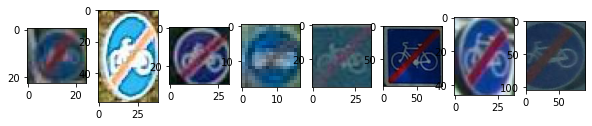

regulatory--end-of-maximum-speed-limit-70--g1
50


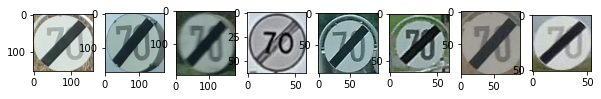

regulatory--end-of-no-parking--g1
32


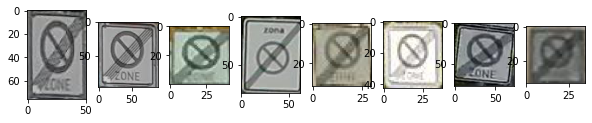

regulatory--end-of-priority-road--g1
79


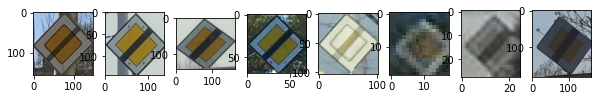

regulatory--end-of-prohibition--g1
72


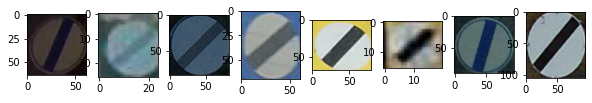

regulatory--end-of-speed-limit-zone--g1
101


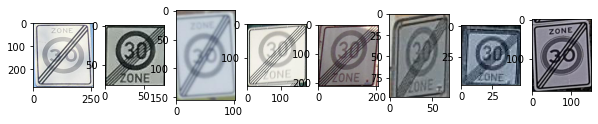

regulatory--give-way-to-oncoming-traffic--g1
66


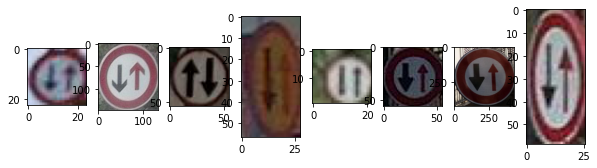

regulatory--go-straight--g1
424


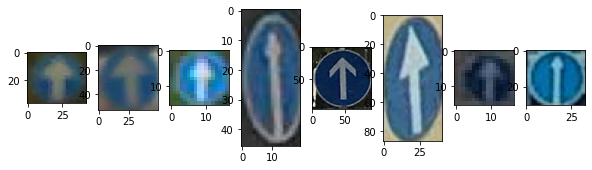

regulatory--go-straight--g3
59


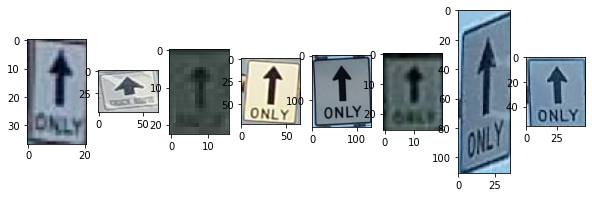

regulatory--go-straight-or-turn-left--g1
133


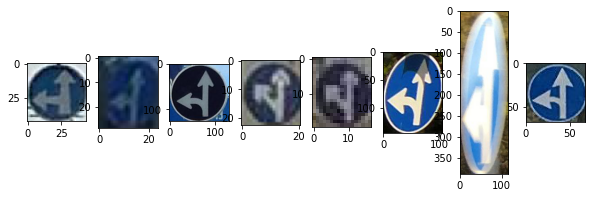

regulatory--go-straight-or-turn-left--g2
57


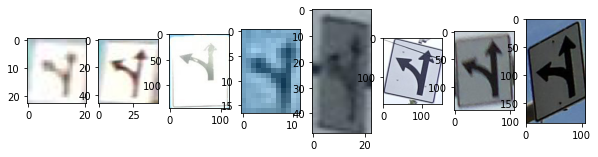

regulatory--go-straight-or-turn-left--g3
85


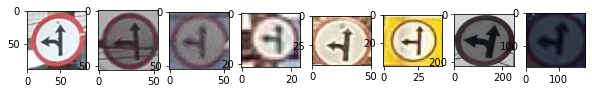

regulatory--go-straight-or-turn-right--g1
114


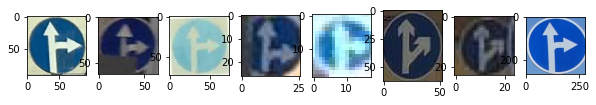

regulatory--go-straight-or-turn-right--g3
51


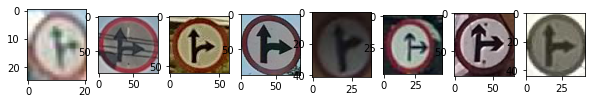

regulatory--height-limit--g1
401


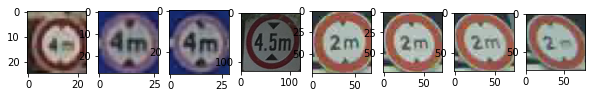

regulatory--keep-left--g1
396


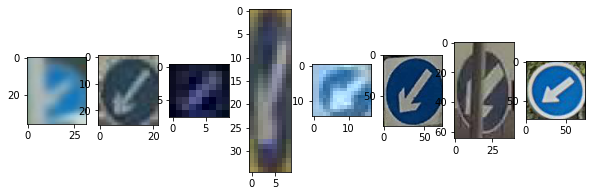

regulatory--keep-left--g2
116


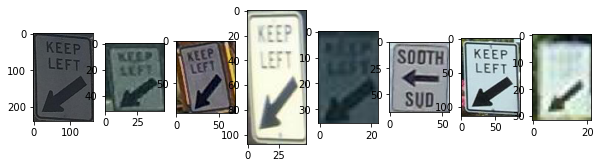

regulatory--keep-right--g1
1077


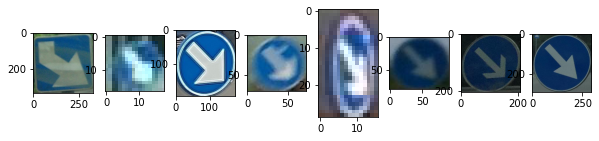

regulatory--keep-right--g2
50


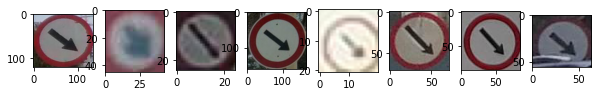

regulatory--keep-right--g4
519


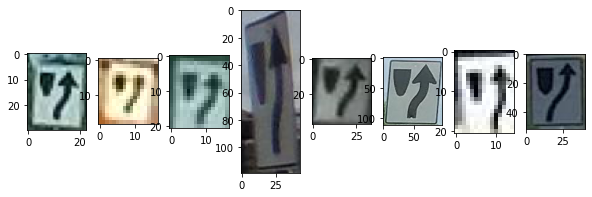

regulatory--keep-right--g6
54


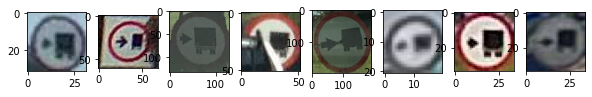

regulatory--lane-control--g1
94


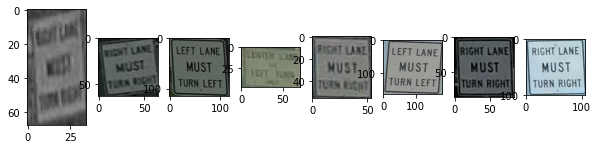

regulatory--left-turn-yield-on-green--g1
88


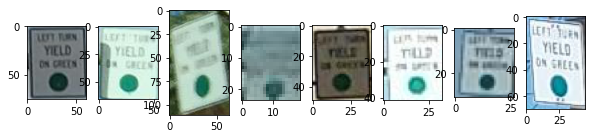

regulatory--maximum-speed-limit-10--g1
96


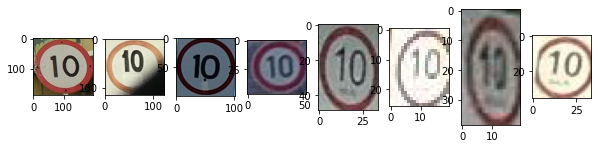

regulatory--maximum-speed-limit-100--g1
169


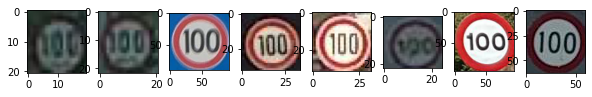

regulatory--maximum-speed-limit-100--g3
82


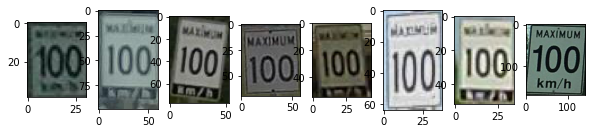

regulatory--maximum-speed-limit-110--g1
105


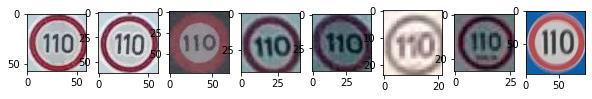

regulatory--maximum-speed-limit-120--g1
94


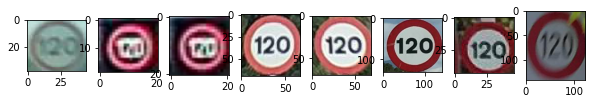

regulatory--maximum-speed-limit-20--g1
195


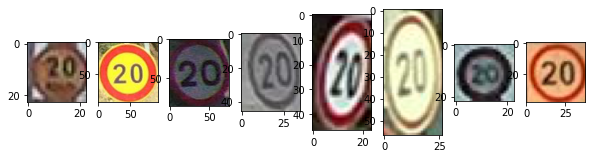

regulatory--maximum-speed-limit-25--g2
186


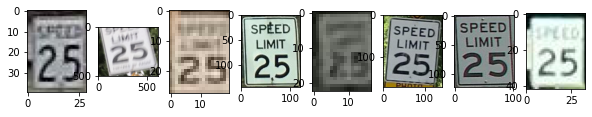

regulatory--maximum-speed-limit-30--g1
648


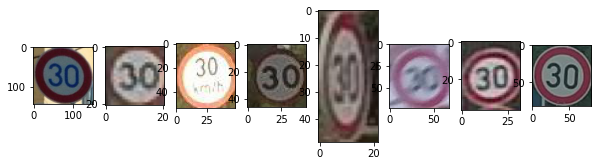

regulatory--maximum-speed-limit-30--g3
88


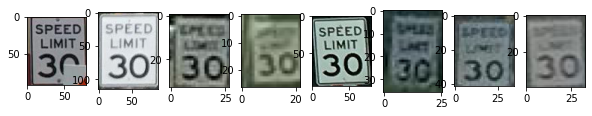

regulatory--maximum-speed-limit-35--g2
136


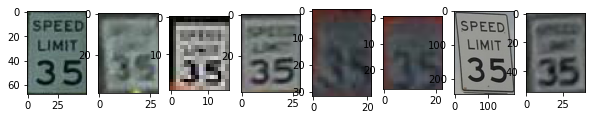

regulatory--maximum-speed-limit-40--g1
855


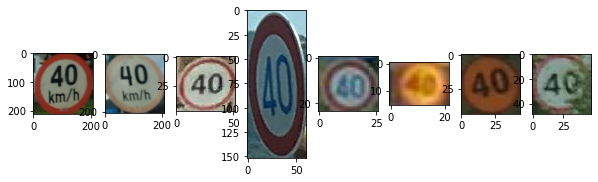

regulatory--maximum-speed-limit-40--g3
80


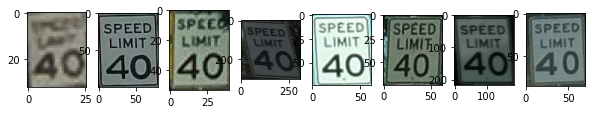

regulatory--maximum-speed-limit-45--g3
89


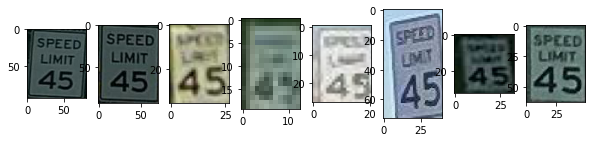

regulatory--maximum-speed-limit-5--g1
94


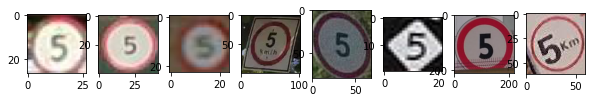

regulatory--maximum-speed-limit-50--g1
612


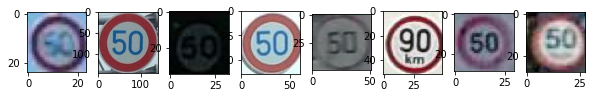

regulatory--maximum-speed-limit-55--g2
126


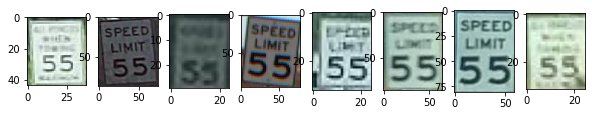

regulatory--maximum-speed-limit-60--g1
567


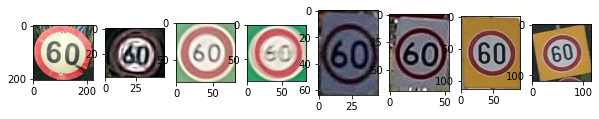

regulatory--maximum-speed-limit-70--g1
296


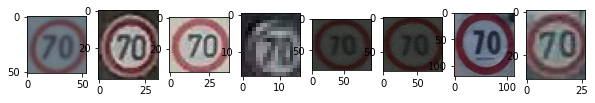

regulatory--maximum-speed-limit-80--g1
358


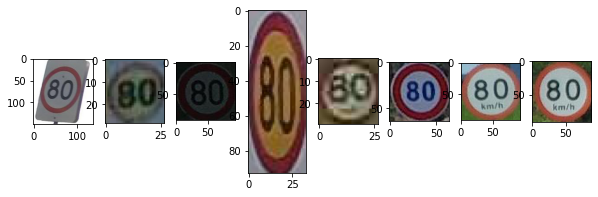

regulatory--maximum-speed-limit-90--g1
222


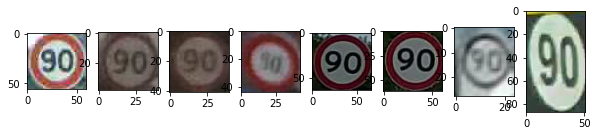

regulatory--maximum-speed-limit-led-100--g1
64


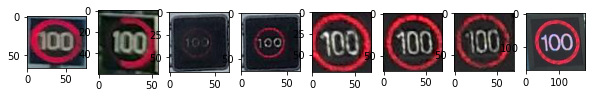

regulatory--maximum-speed-limit-led-60--g1
54


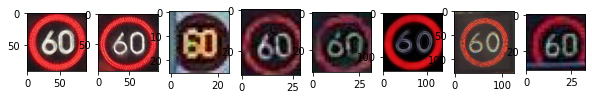

regulatory--maximum-speed-limit-led-80--g1
44


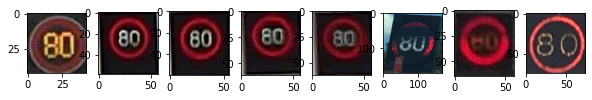

regulatory--mopeds-and-bicycles-only--g1
101


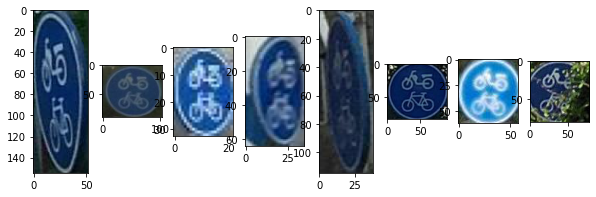

regulatory--no-bicycles--g1
64


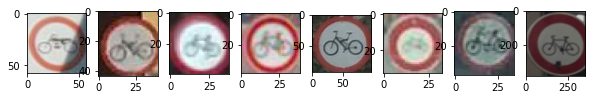

regulatory--no-bicycles--g2
66


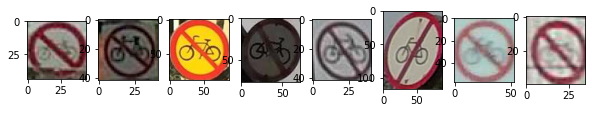

regulatory--no-buses--g3
45


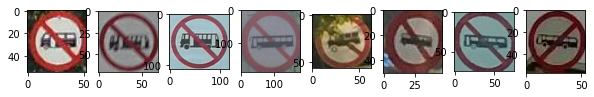

regulatory--no-entry--g1
1768


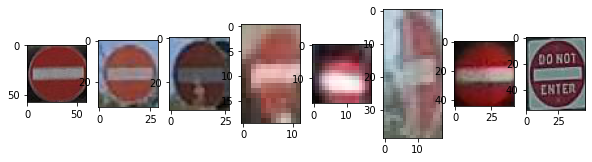

regulatory--no-heavy-goods-vehicles--g1
315


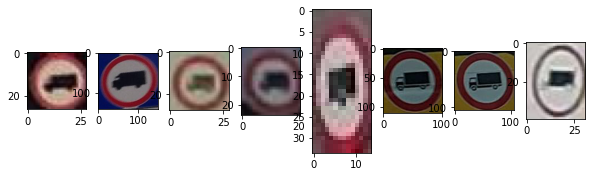

regulatory--no-heavy-goods-vehicles--g2
377


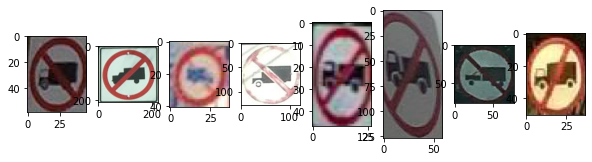

regulatory--no-heavy-goods-vehicles--g4
279


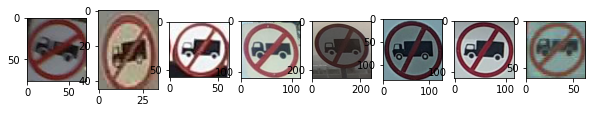

regulatory--no-heavy-goods-vehicles--g5
53


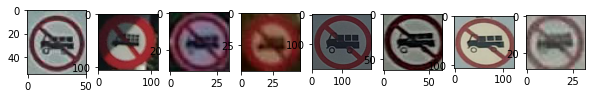

regulatory--no-left-turn--g1
415


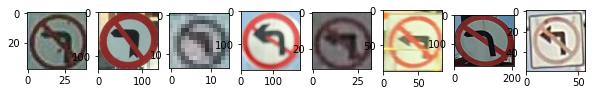

regulatory--no-left-turn--g2
61


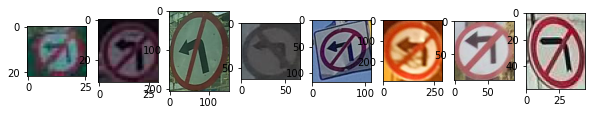

regulatory--no-motor-vehicles-except-motorcycles--g1
50


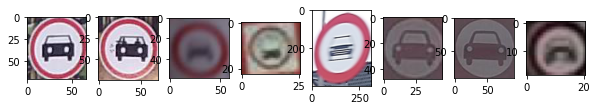

regulatory--no-motor-vehicles-except-motorcycles--g2
111


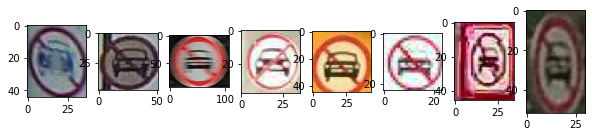

regulatory--no-motorcycles--g1
77


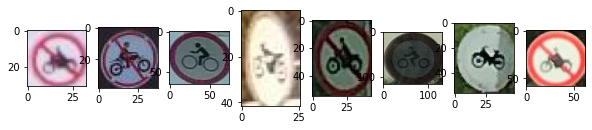

regulatory--no-motorcycles--g2
56


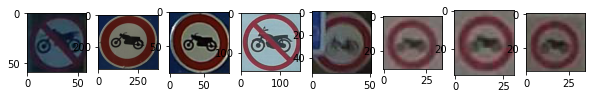

regulatory--no-overtaking--g1
243


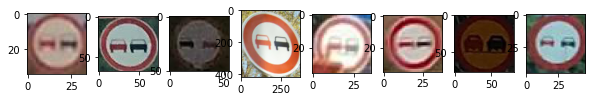

regulatory--no-overtaking--g2
197


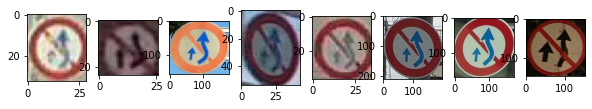

regulatory--no-overtaking--g4
44


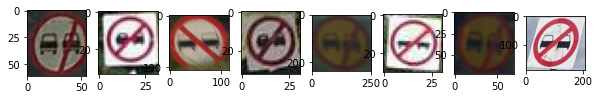

regulatory--no-overtaking--g5
332


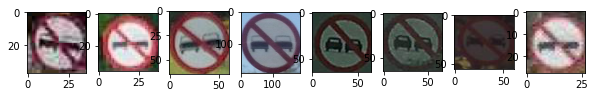

regulatory--no-overtaking-by-heavy-goods-vehicles--g1
53


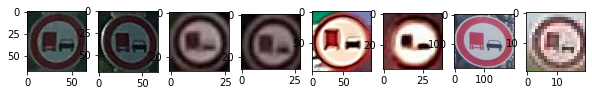

regulatory--no-parking--g1
961


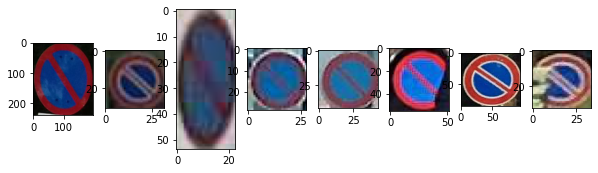

regulatory--no-parking--g2
518


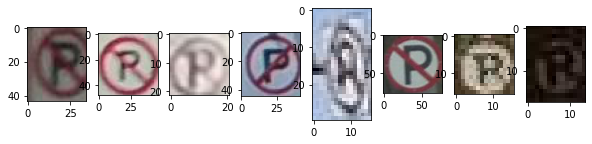

regulatory--no-parking--g5
513


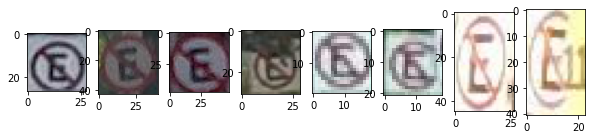

regulatory--no-parking--g6
6


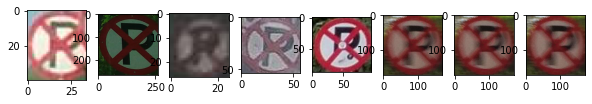

regulatory--no-parking-or-no-stopping--g1
72


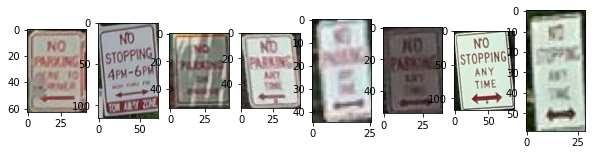

regulatory--no-parking-or-no-stopping--g2
70


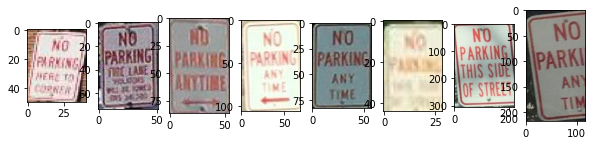

regulatory--no-parking-or-no-stopping--g3
93


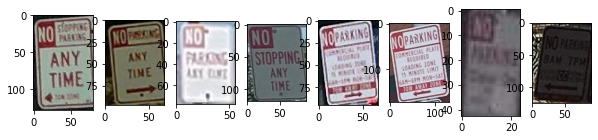

regulatory--no-parking-or-no-stopping--g5
28


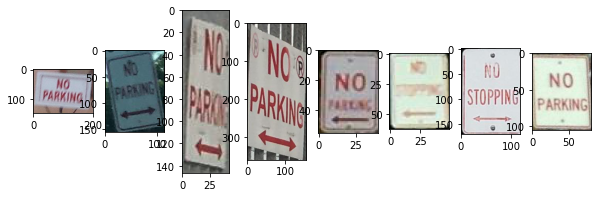

regulatory--no-pedestrians--g1
79


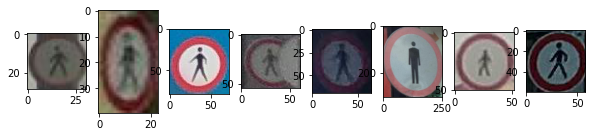

regulatory--no-pedestrians--g2
138


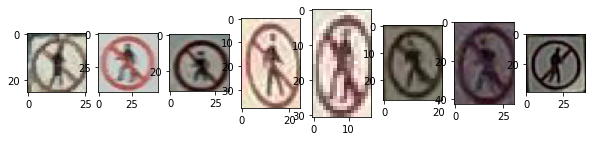

regulatory--no-right-turn--g1
242


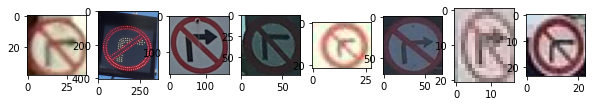

regulatory--no-right-turn--g2
99


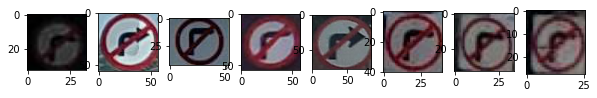

regulatory--no-stopping--g1
982


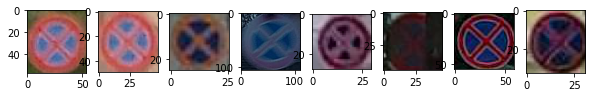

regulatory--no-stopping--g2
247


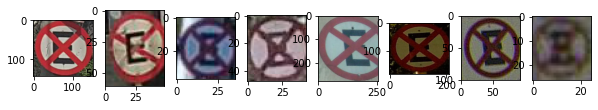

regulatory--no-stopping--g5
152


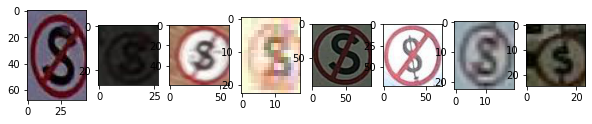

regulatory--no-straight-through--g1
68


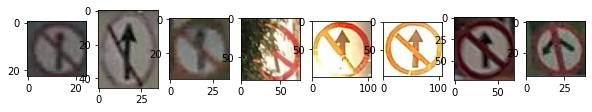

regulatory--no-turn-on-red--g1
91


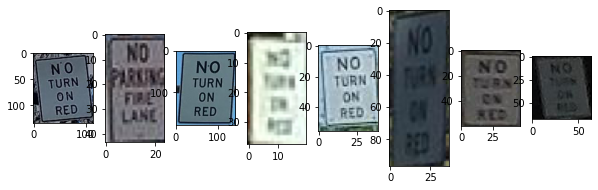

regulatory--no-turn-on-red--g2
89


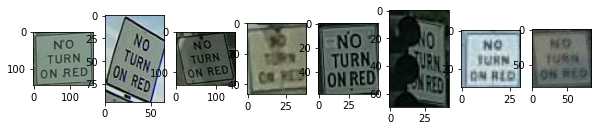

regulatory--no-turn-on-red--g3
52


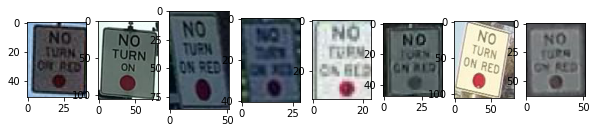

regulatory--no-u-turn--g1
406


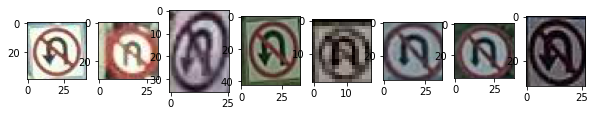

regulatory--no-u-turn--g2
41


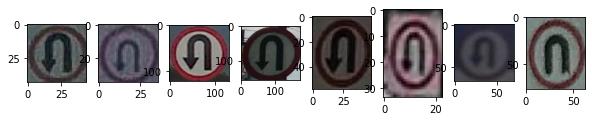

regulatory--no-u-turn--g3
80


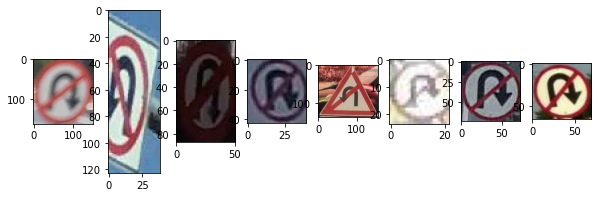

regulatory--no-vehicles-carrying-dangerous-goods--g1
106


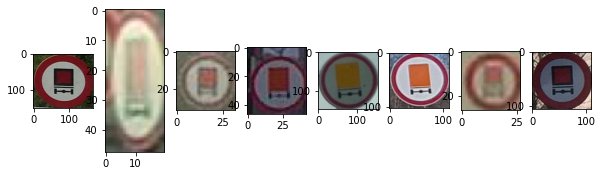

regulatory--one-way-left--g1
299


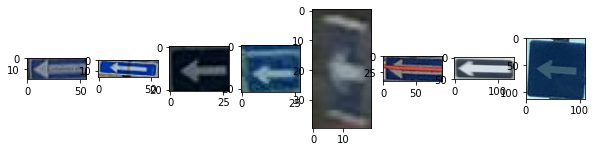

regulatory--one-way-left--g2
129


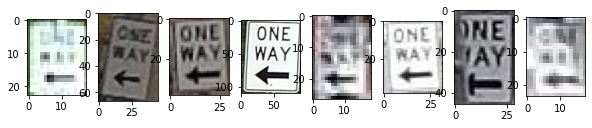

regulatory--one-way-left--g3
294


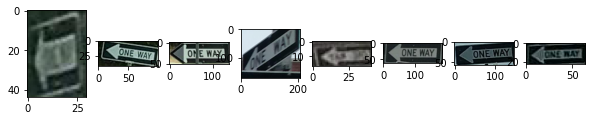

regulatory--one-way-right--g1
241


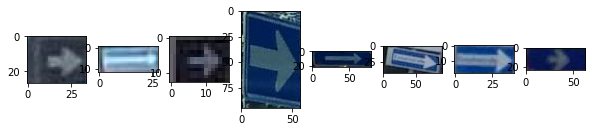

regulatory--one-way-right--g2
88


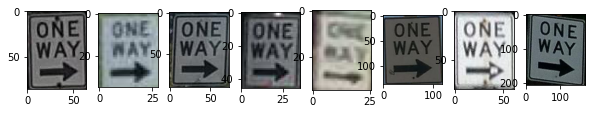

regulatory--one-way-right--g3
281


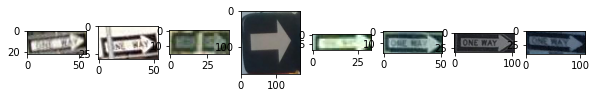

regulatory--one-way-straight--g1
368


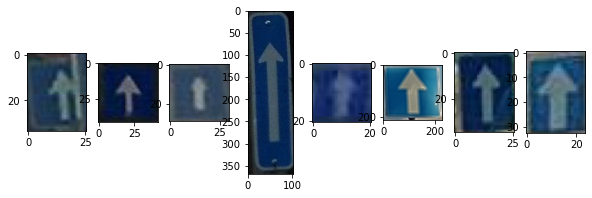

regulatory--parking-restrictions--g2
51


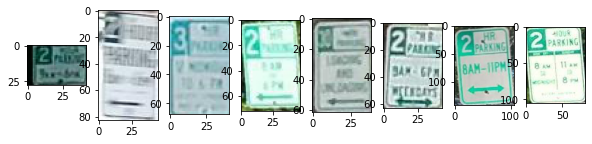

regulatory--pass-on-either-side--g1
274


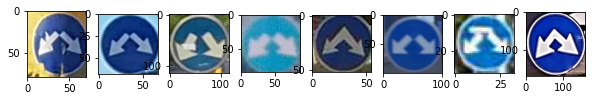

regulatory--pass-on-either-side--g2
49


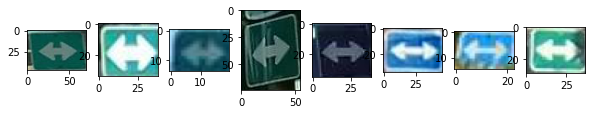

regulatory--passing-lane-ahead--g1
41


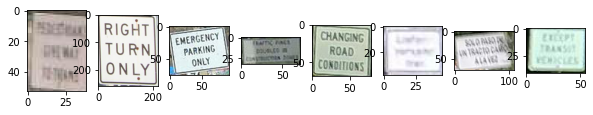

regulatory--pedestrians-only--g1
149


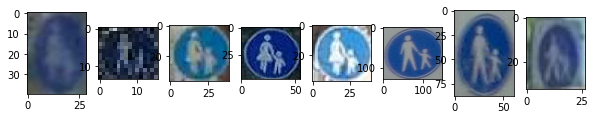

regulatory--pedestrians-only--g2
39


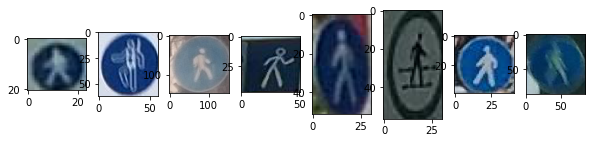

regulatory--priority-over-oncoming-vehicles--g1
102


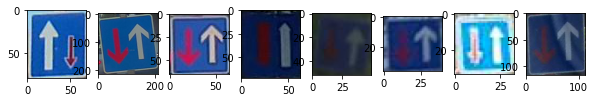

regulatory--priority-road--g1
1014


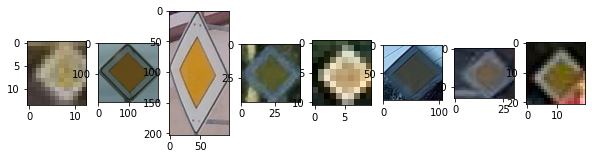

regulatory--radar-enforced--g1
89


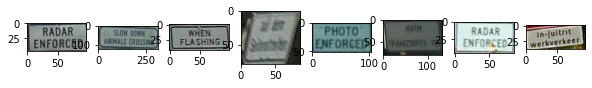

regulatory--reversible-lanes--g2
103


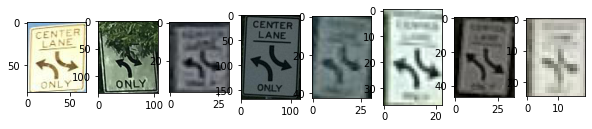

regulatory--road-closed--g2
73


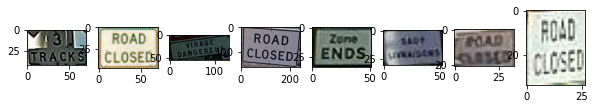

regulatory--road-closed-to-vehicles--g1
34


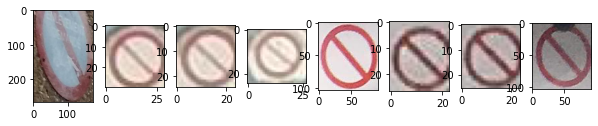

regulatory--road-closed-to-vehicles--g3
236


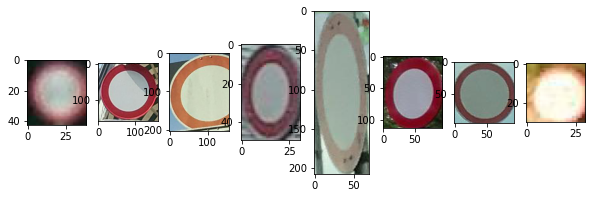

regulatory--roundabout--g1
339


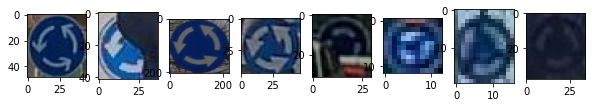

regulatory--shared-path-bicycles-and-pedestrians--g1
18


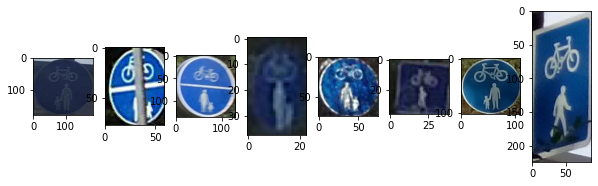

regulatory--shared-path-pedestrians-and-bicycles--g1
211


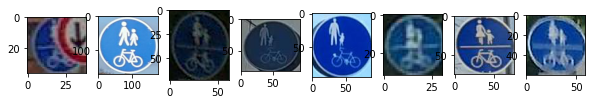

regulatory--stop--g1
1213


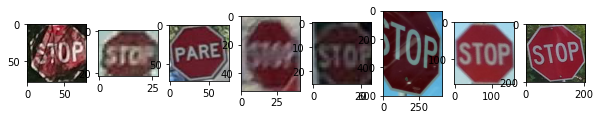

regulatory--stop--g10
46


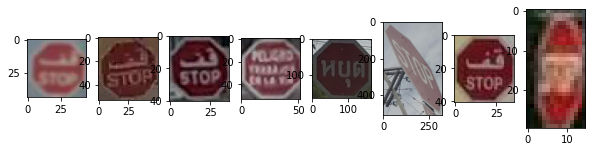

regulatory--stop--g2
45


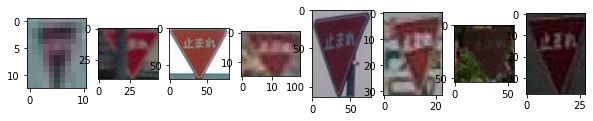

regulatory--stop-here-on-red-or-flashing-light--g1
75


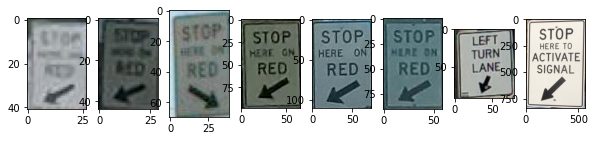

regulatory--stop-here-on-red-or-flashing-light--g2
43


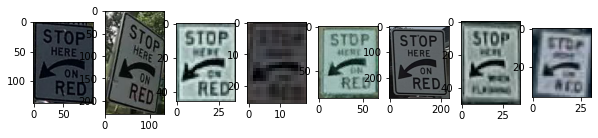

regulatory--stop-signals--g1
44


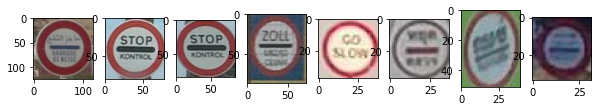

regulatory--triple-lanes-turn-left-center-lane--g1
45


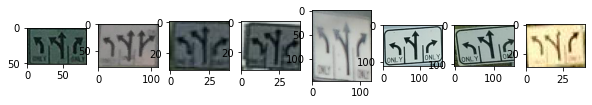

regulatory--turn-left--g1
148


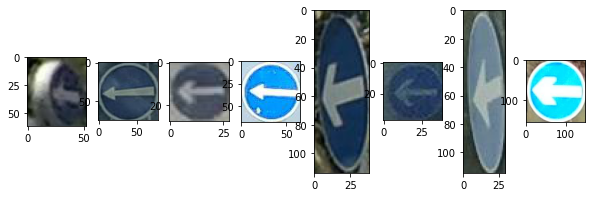

regulatory--turn-left--g2
226


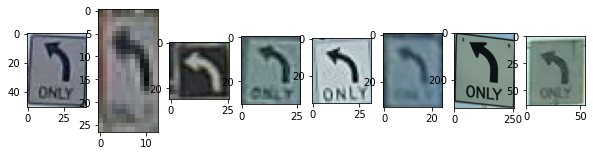

regulatory--turn-left--g3
87


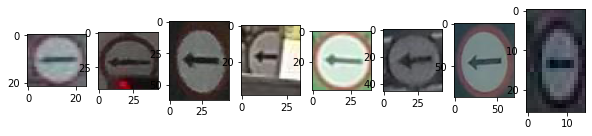

regulatory--turn-left-ahead--g1
107


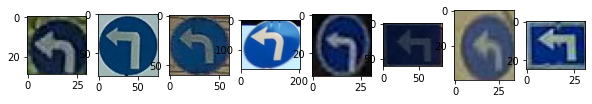

regulatory--turn-right--g1
275


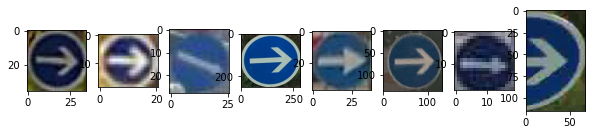

regulatory--turn-right--g2
81


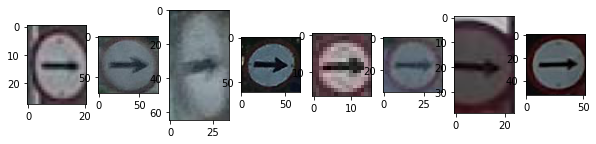

regulatory--turn-right--g3
127


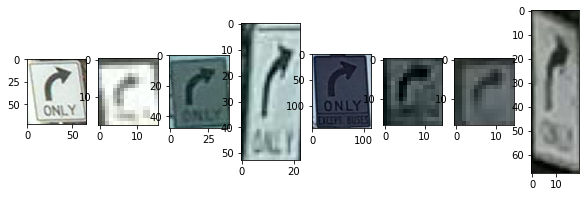

regulatory--turn-right-ahead--g1
157


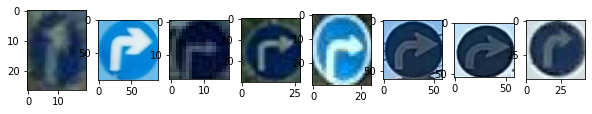

regulatory--u-turn--g1
73


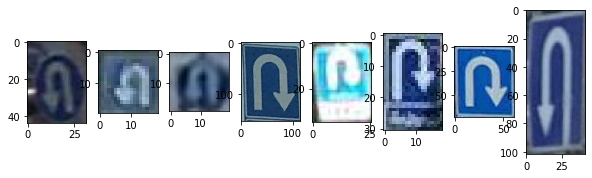

regulatory--weight-limit--g1
190


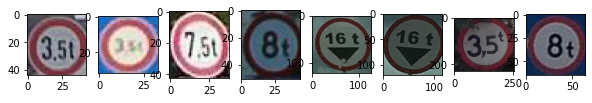

regulatory--wrong-way--g1
64


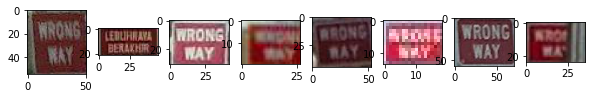

regulatory--yield--g1
2428


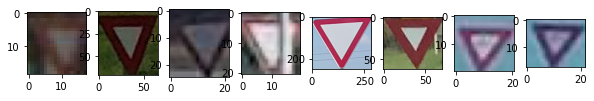

warning--added-lane-right--g1
45


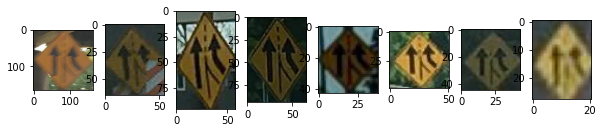

warning--bicycles-crossing--g1
48


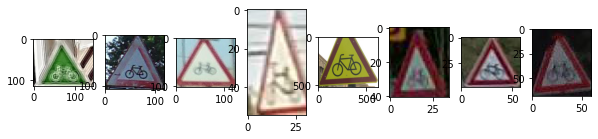

warning--bicycles-crossing--g2
75


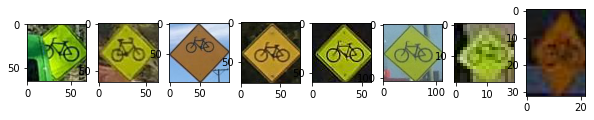

warning--children--g1
219


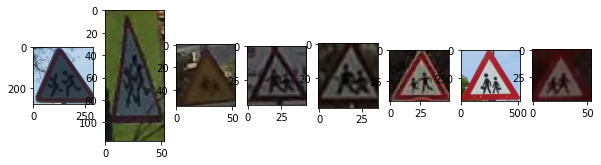

warning--children--g2
52


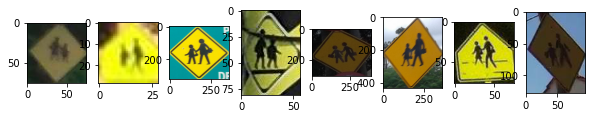

warning--children--g5
274


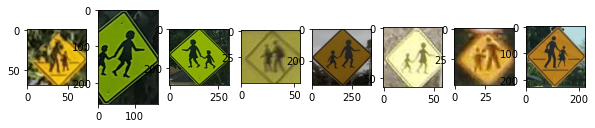

warning--crossroads--g1
164


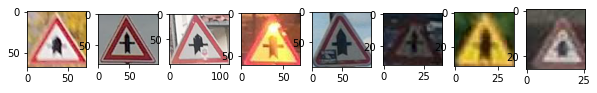

warning--crossroads--g3
152


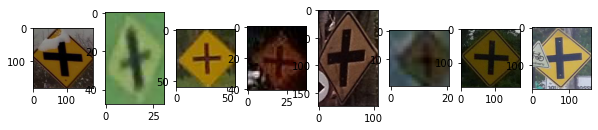

warning--crossroads-with-priority-to-the-right--g1
47


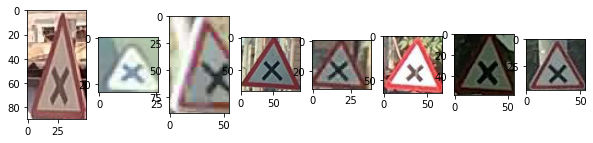

warning--curve-left--g1
212


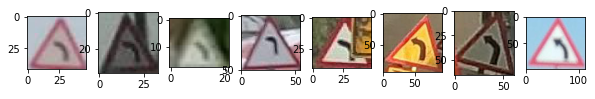

warning--curve-left--g2
500


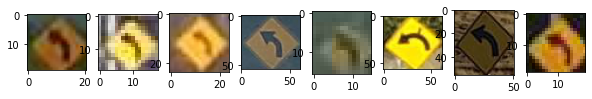

warning--curve-right--g1
238


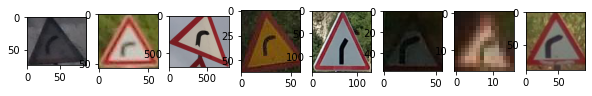

warning--curve-right--g2
408


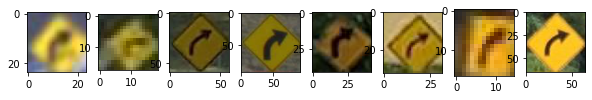

warning--divided-highway-ends--g1
76


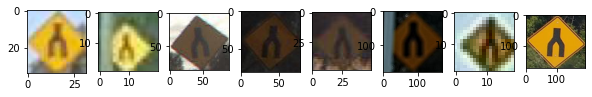

warning--divided-highway-ends--g2
107


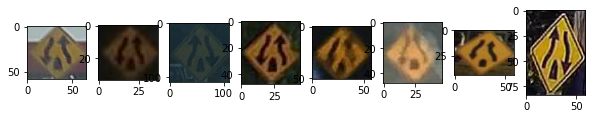

warning--domestic-animals--g1
40


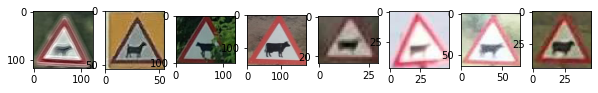

warning--double-curve-first-left--g1
99


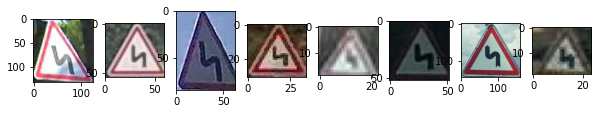

warning--double-curve-first-left--g2
88


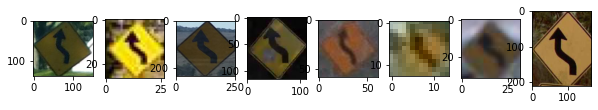

warning--double-curve-first-right--g1
124


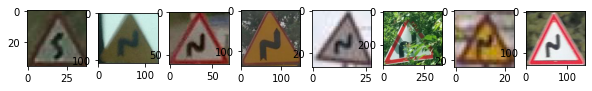

warning--double-curve-first-right--g2
105


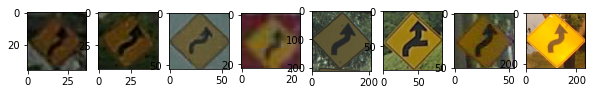

warning--double-reverse-curve-right--g1
52


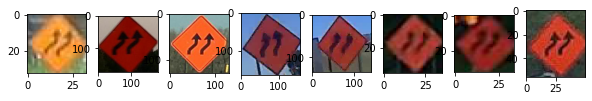

warning--double-turn-first-right--g1
50


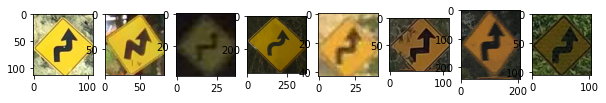

warning--dual-lanes-right-turn-or-go-straight--g1
51


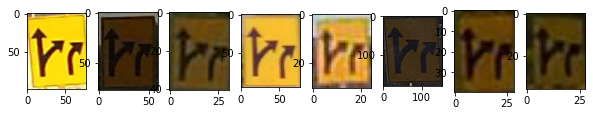

warning--emergency-vehicles--g1
73


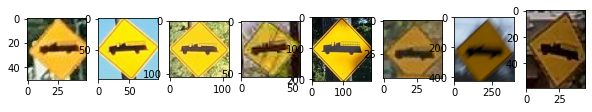

warning--falling-rocks-or-debris-right--g2
58


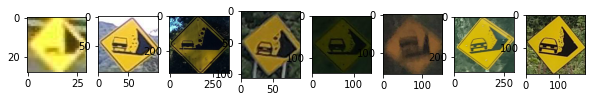

warning--flaggers-in-road--g1
47


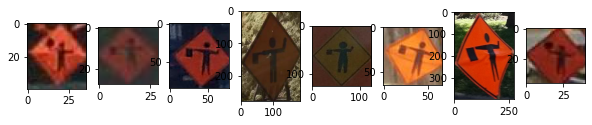

warning--hairpin-curve-right--g1
53


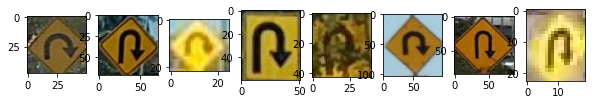

warning--height-restriction--g2
166


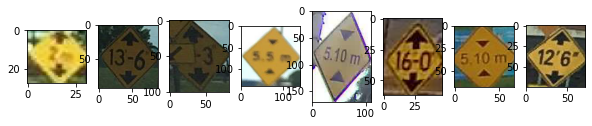

warning--horizontal-alignment-left--g1
53


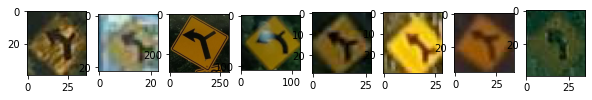

warning--horizontal-alignment-right--g1
82


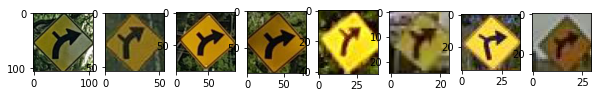

warning--junction-with-a-side-road-acute-left--g1
110


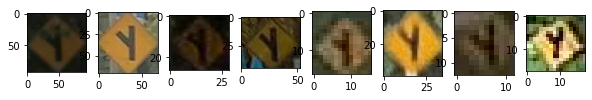

warning--junction-with-a-side-road-acute-right--g1
81


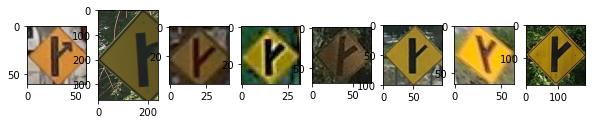

warning--junction-with-a-side-road-perpendicular-left--g1
121


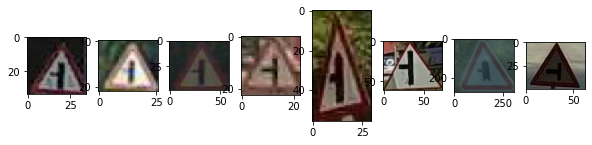

warning--junction-with-a-side-road-perpendicular-left--g3
134


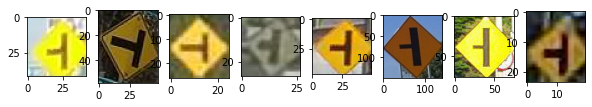

warning--junction-with-a-side-road-perpendicular-right--g1
248


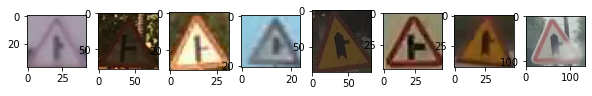

warning--junction-with-a-side-road-perpendicular-right--g3
158


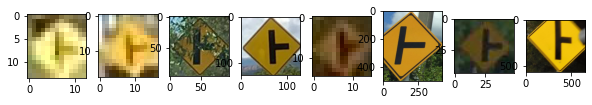

warning--kangaloo-crossing--g1
108


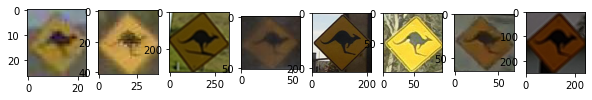

warning--narrow-bridge--g1
164


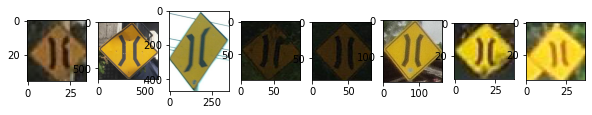

warning--narrow-bridge--g3
54


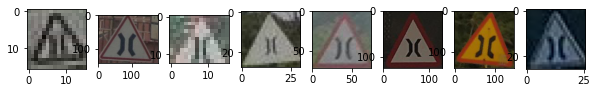

warning--other-danger--g1
355


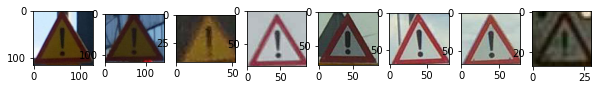

warning--pass-left-or-right--g2
120


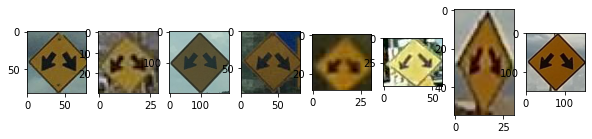

warning--pedestrians-crossing--g1
266


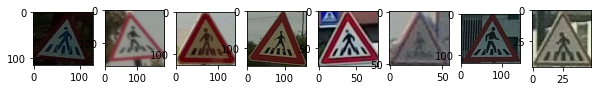

warning--pedestrians-crossing--g10
46


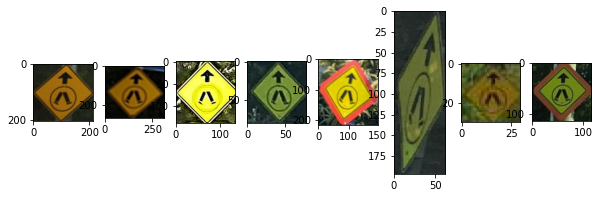

warning--pedestrians-crossing--g12
13


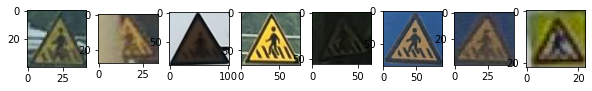

warning--pedestrians-crossing--g4
805


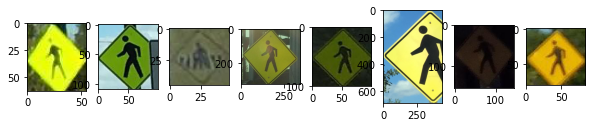

warning--pedestrians-crossing--g5
148


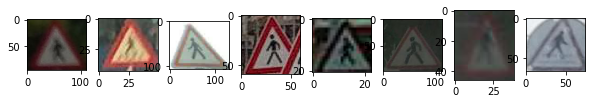

warning--railroad-crossing--g1
71


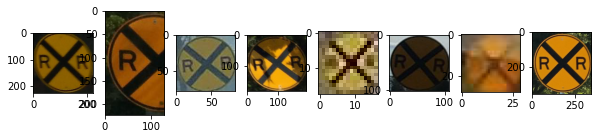

warning--railroad-crossing--g3
53


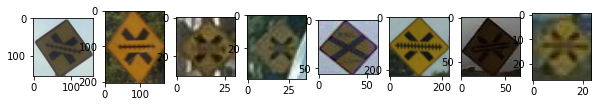

warning--railroad-crossing--g4
261


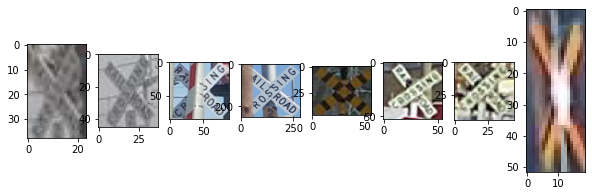

warning--railroad-crossing-with-barriers--g1
90


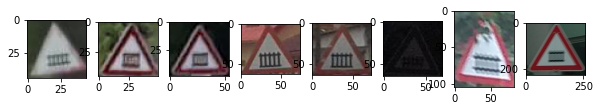

warning--railroad-crossing-with-barriers--g2
43


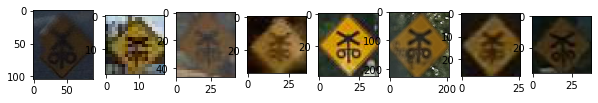

warning--railroad-crossing-without-barriers--g1
74


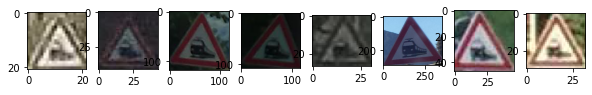

warning--railroad-crossing-without-barriers--g3
134


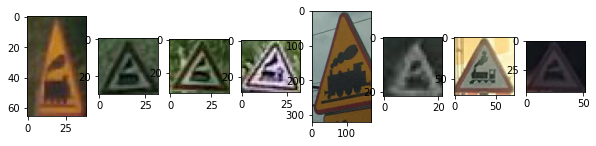

warning--railroad-crossing-without-barriers--g4
136


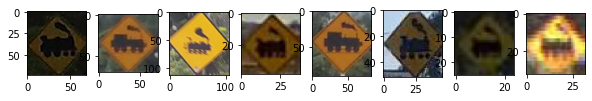

warning--railroad-intersection--g3
95


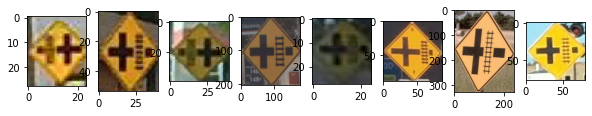

warning--road-bump--g1
373


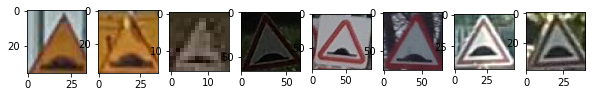

warning--road-bump--g2
479


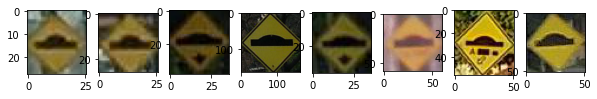

warning--road-narrows--g1
102


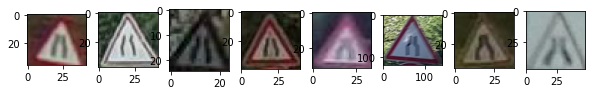

warning--road-narrows--g2
50


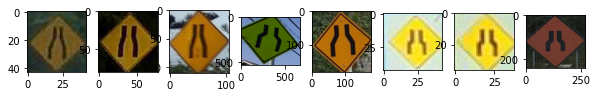

warning--road-narrows-left--g1
52


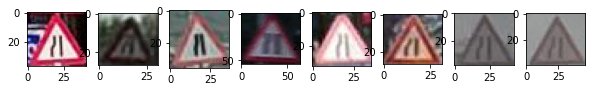

warning--road-narrows-left--g2
110


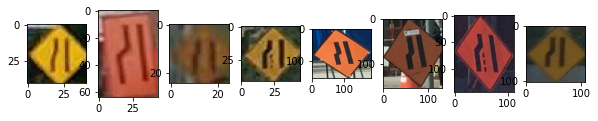

warning--road-narrows-right--g1
46


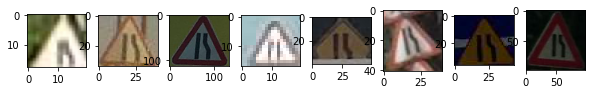

warning--road-narrows-right--g2
115


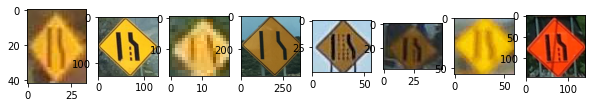

warning--road-widens--g1
48


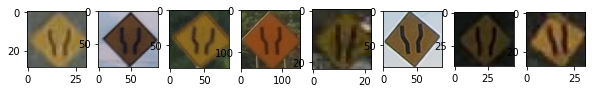

warning--road-widens-right--g1
68


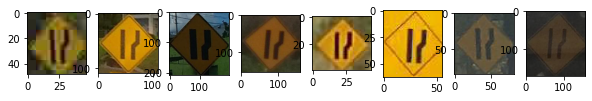

warning--roadworks--g1
298


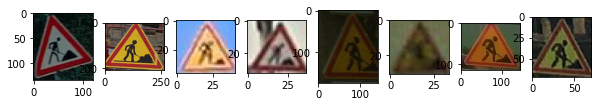

warning--roadworks--g2
50


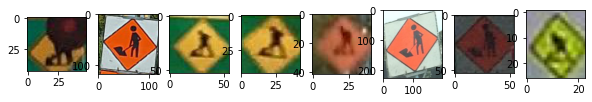

warning--roadworks--g3
85


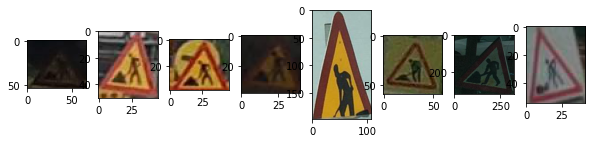

warning--roadworks--g4
58


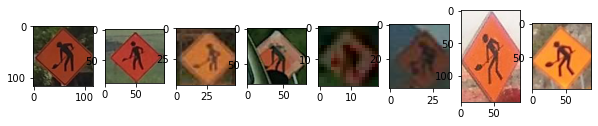

warning--roadworks--g6
13


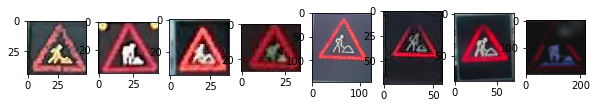

warning--roundabout--g1
131


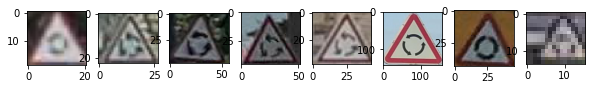

warning--roundabout--g2
106


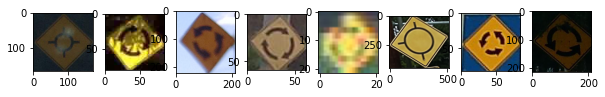

warning--school-zone--g2
236


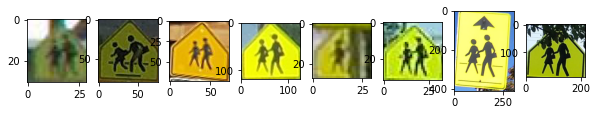

warning--slippery-road-surface--g1
224


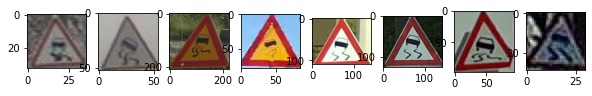

warning--slippery-road-surface--g2
210


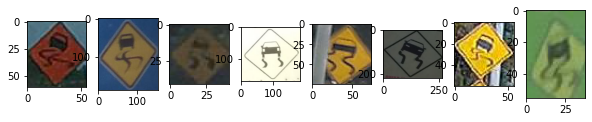

warning--steep-descent--g2
67


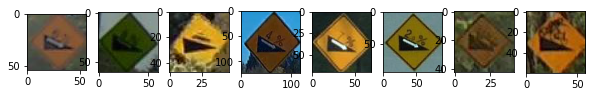

warning--stop-ahead--g1
147


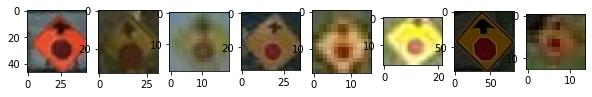

warning--t-roads--g2
40


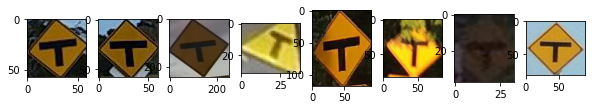

warning--texts--g1
144


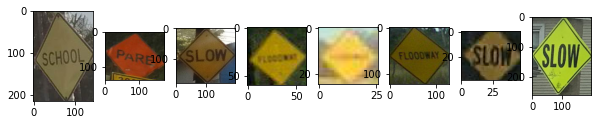

warning--texts--g2
260


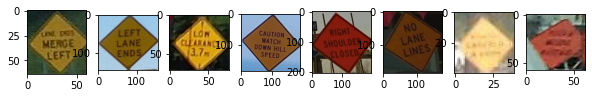

warning--texts--g3
149


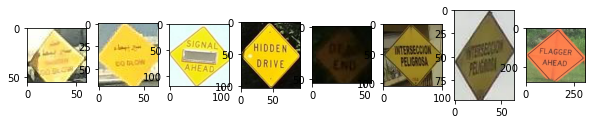

warning--traffic-merges-left--g1
78


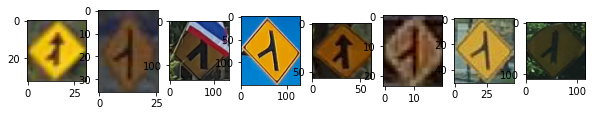

warning--traffic-merges-right--g1
222


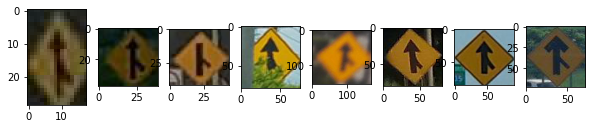

warning--traffic-merges-right--g2
110


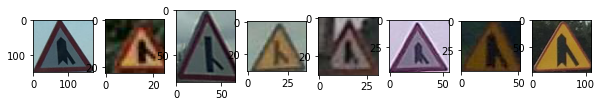

warning--traffic-signals--g1
178


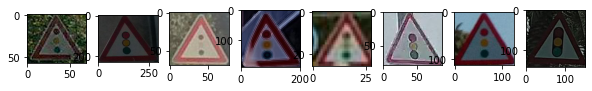

warning--traffic-signals--g2
66


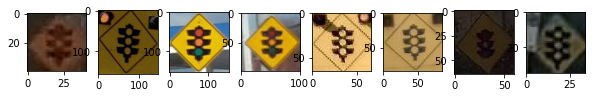

warning--traffic-signals--g3
211


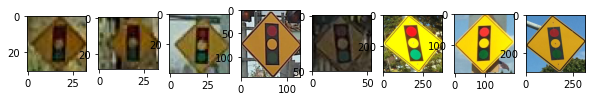

warning--trail-crossing--g2
88


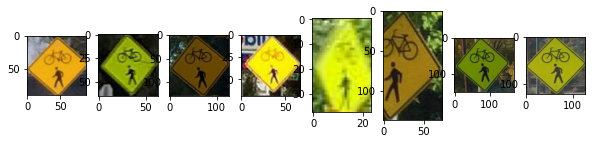

warning--trucks-crossing--g1
117


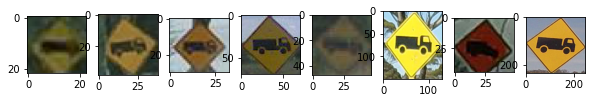

warning--turn-left--g1
110


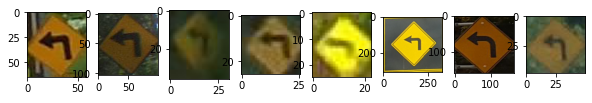

warning--turn-right--g1
186


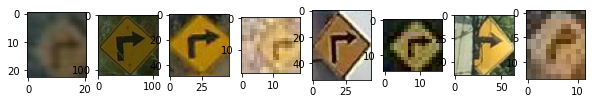

warning--two-way-traffic--g1
59


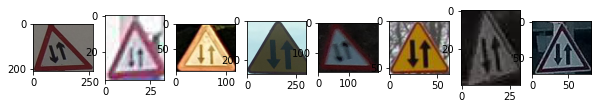

warning--two-way-traffic--g2
80


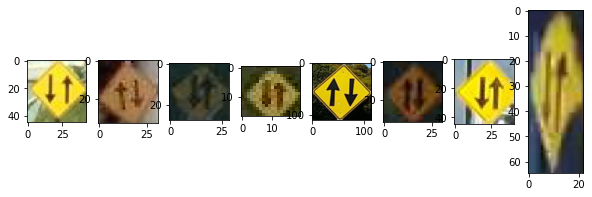

warning--uneven-road--g1
98


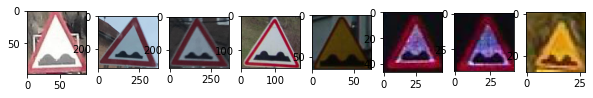

warning--wild-animals--g1
56


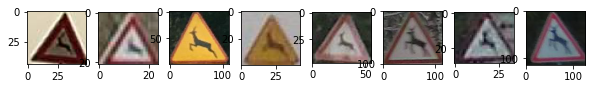

warning--winding-road-first-left--g1
136


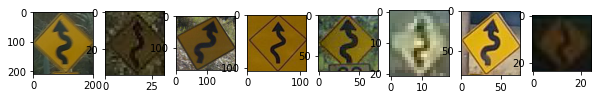

warning--winding-road-first-right--g1
128


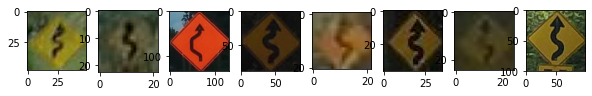

warning--winding-road-first-right--g3
18


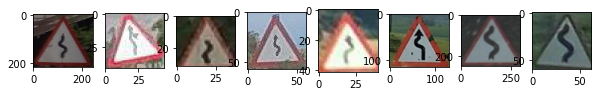

warning--y-roads--g1
43


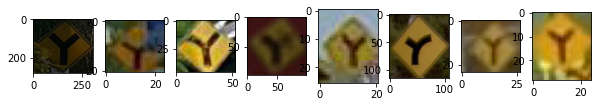

In [10]:
#sorted_labels = train_labels.most_common()

#for lab in sorted(list(filter(lambda l: 'g3' in l, warning_signs))):
for lab in sorted(label_names):
#     lab = sorted_labels[1][0]
    print(lab)
    print(train_labels[lab])
    imgs = get_x_imgs(lab,8)
    disp_imgs(imgs)

In [19]:
#TODO: wyswietl wiele other-sign i ogarnij, czy je w ogole opłaca się wyswietlac
combined_labels =[]
combined_labels.append(('information--airport--g2', 'information--airport--g1'))
#combined_labels.append(('regulatory--no-heavy-goods-vehicles--g1', 'regulatory--no-heavy-goods-vehicles--g4', 'regulatory--no-heavy-goods-vehicles--g5'))
combined_labels.append(('warning--texts--g1', 'warning--texts--g2', 'warning--texts--g3'))
combined_labels.append(('information--parking--g5', 'information--parking--g1'))
combined_labels.append(("regulatory--one-way-left--g1", "regulatory--one-way-left--g3"))
imgs = []
axes=[]
rows = len(combined_labels)
columns=3
fig=plt.figure(figsize=(10, 3))
i=0
for comb_l in combined_labels:
    #rows = rows+1
    #columns = len(comb_l)
    i=i+(i%3//2)
    #print(i)
    for l in comb_l:
        i=i+1
        #imgs.append(get_x_imgs(l, 1)[0])
        axes.append(fig.add_subplot(rows, columns, i))
        axes[-1].set_title(l)
        imgs.append(get_x_imgs(l, 1)[0])
        if l !="regulatory--one-way-left--g3":
            while((imgs[-1].shape[0] * imgs[-1].shape[1]) < 1200):
                imgs[-1]= get_x_imgs(l, 1)[0]
        plt.imshow(imgs[-1])
    
    #for i in range(imgs)
#     for i in range(1, columns*rows +1):
#         axes.append(fig.add_subplot(rows, columns, i))
#         axes[-1].set_title(combined_labels[])
#         plt.imshow(imgs[min(i-1,len(imgs)-1)])
fig.tight_layout()
plt.show()

In [ ]:
#TODO: wyswietl wiele other-sign i ogarnij, czy je w ogole opłaca się wyswietlac
combined_labels =[]
combined_labels.append(('information--airport--g2', 'information--airport--g1'))
#combined_labels.append(('regulatory--no-heavy-goods-vehicles--g1', 'regulatory--no-heavy-goods-vehicles--g4', 'regulatory--no-heavy-goods-vehicles--g5'))
combined_labels.append(('warning--texts--g1', 'warning--texts--g2', 'warning--texts--g3'))
combined_labels.append(('information--parking--g5', 'information--parking--g1'))
combined_labels.append(("regulatory--one-way-left--g1", "regulatory--one-way-left--g3"))
imgs = []
axes=[]
rows = len(combined_labels)
columns=3
fig=plt.figure(figsize=(10, 3))
i=0
for comb_l in combined_labels:
    #rows = rows+1
    #columns = len(comb_l)
    i=i+(i%3//2)
    #print(i)
    for l in comb_l:
        i=i+1
        #imgs.append(get_x_imgs(l, 1)[0])
        axes.append(fig.add_subplot(rows, columns, i))
        axes[-1].set_title(l)
        imgs.append(get_x_imgs(l, 1)[0])
        if l !="regulatory--one-way-left--g3":
            while((imgs[-1].shape[0] * imgs[-1].shape[1]) < 1200):
                imgs[-1]= get_x_imgs(l, 1)[0]
        plt.imshow(imgs[-1])
    
    #for i in range(imgs)
#     for i in range(1, columns*rows +1):
#         axes.append(fig.add_subplot(rows, columns, i))
#         axes[-1].set_title(combined_labels[])
#         plt.imshow(imgs[min(i-1,len(imgs)-1)])
fig.tight_layout()
plt.show()

In [25]:
len(list(filter(lambda l: 'g3' in l, label_names)))

33

In [49]:
lbls=['information--end-of-built-up-area--g1', 'other-sign']
train_annotations[train[10]]['objects'] = [obj for obj in train_annotations[train[10]]['objects'] if obj['label'] not in lbls]


In [51]:
train_annotations[train[10]]

{'width': 1920, 'objects': [], 'ispano': False, 'height': 1080}

In [27]:
f = open("/home/pkost/Desktop/test.json", "w")
json.dumps(train_annotations[train[1]], f)

TypeError: dumps() takes 1 positional argument but 2 were given

In [9]:
import pandas as pd

In [10]:
objects = [{**obj["properties"], **obj["bbox"], "key": obj["key"], "label": obj["label"]} 
           for x in train_annotations.values() for obj in x["objects"]]

In [11]:
df = pd.DataFrame(objects)

<AxesSubplot:ylabel='label'>

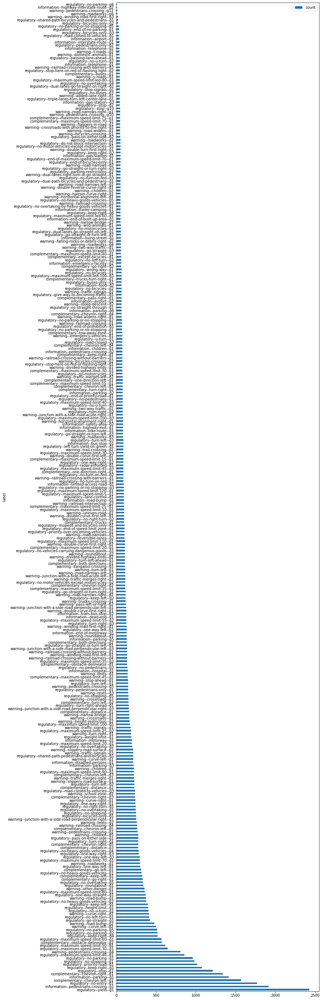

In [12]:
df.groupby("label").agg(count=("key", "count")).reset_index().sort_values("count", ascending=False).query("label!='other-sign'").plot(kind="barh", x="label", y="count", figsize=(10,50))

In [21]:
lbls= list(labels.keys())

In [58]:

i = 0
for l in labels.items():
    if(l[1]>=50):
        i=i+1
i

271

In [46]:
labels['warning--traffic-merges-right--g1']

222

In [63]:
    filtered_lbls_map ={e:i for i,e in enumerate(lbls)}

In [67]:
filtered_lbls_map.values()

dict_values([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 21